### CS303 - Mathematical Foundations for AI
# Coding Assignment

--- 

#### __Problem 1.__ This assignment explores _Diffusion Maps_, a manifold learning technique, to _cluster time-series data_. You will work with the _UCI Human Activity Recognition (HAR) dataset_ and apply Diffusion Maps for dimensionality reduction before clustering. The goal is to analyze how well this approach separates human motion activities.

In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import random
import os
from dtaidistance import dtw
from dtaidistance import dtw_ndim
from scipy.spatial import distance
from scipy.linalg import eigh

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

> Dataset Description
> - Overlapping samples of window length 128, overlap 64, windowed from original readings at 50Hz
> - 7352 samples, distributed among 30 volunteers and 6 activities.
> - Each sample consists of accelerometer and gyroscope time-series data.
> - Accelerometer data consists of: total/body acceleration in 3 axes: X, Y, Z in units of standard gravity (g), where each reading is 128 numbers long

##### I am using the `body acceleration` data in X, Y and Z directions (3 dimensions) for training and testing

In [2]:
def load_data(set = "train"):
    '''loads the data body accelerometer data from the UCI HAR dataset for the specified set (train or test)'''
    body_acc_x  = np.loadtxt(os.path.join('UCI HAR Dataset', set, "Inertial Signals", f'total_acc_x_{set}.txt'))
    body_acc_y  = np.loadtxt(os.path.join('UCI HAR Dataset', set, "Inertial Signals", f'total_acc_y_{set}.txt'))
    body_acc_z  = np.loadtxt(os.path.join('UCI HAR Dataset', set, "Inertial Signals", f'total_acc_z_{set}.txt'))
    y = np.loadtxt(os.path.join('UCI HAR Dataset', set, f'y_{set}.txt'), dtype=int)

    return np.stack([body_acc_x, body_acc_y, body_acc_z], axis=2), y

X_train, y_train = load_data("train")
X_train.shape, y_train.shape

((7352, 128, 3), (7352,))

In [3]:
print(X_train)

[[[ 1.012817   -0.1232167   0.1029341 ]
  [ 1.022833   -0.1268756   0.1056872 ]
  [ 1.022028   -0.1240037   0.1021025 ]
  ...
  [ 1.018445   -0.1240696   0.1003852 ]
  [ 1.019372   -0.1227451   0.09987355]
  [ 1.021171   -0.121326    0.09498741]]

 [[ 1.018851   -0.123976    0.09792958]
  [ 1.02238    -0.1268078   0.09935086]
  [ 1.020781   -0.1277862   0.09811381]
  ...
  [ 1.014788   -0.1290268   0.0935352 ]
  [ 1.016499   -0.1264244   0.08903516]
  [ 1.017849   -0.1305193   0.09061235]]

 [[ 1.023127   -0.1200157   0.09111667]
  [ 1.021882   -0.1214994   0.0926756 ]
  [ 1.019178   -0.1228407   0.09606378]
  ...
  [ 1.021041   -0.1308757   0.08301135]
  [ 1.022935   -0.1312099   0.08233391]
  [ 1.022019   -0.1301826   0.08148748]]

 ...

 [[ 0.7548917  -0.1711829   0.1745865 ]
  [ 0.8043137  -0.1999375   0.2324243 ]
  [ 0.831714   -0.2319457   0.2576066 ]
  ...
  [ 0.6956257  -0.2217656   0.1112952 ]
  [ 0.7479103  -0.2811496   0.1263023 ]
  [ 0.776768   -0.3275988   0.1886212 ]]

 [

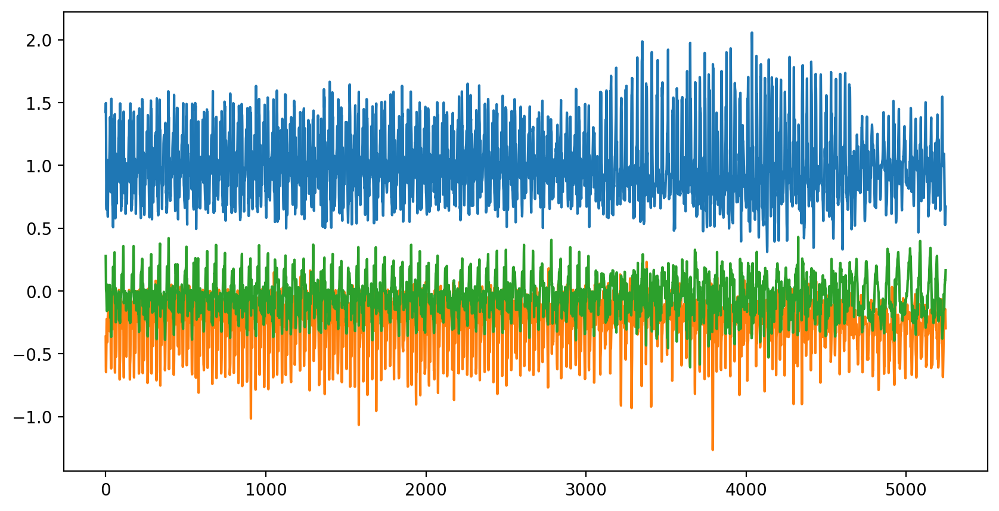

In [4]:
# attach the first 3 samples to the plot
windiow = X_train[79]
for i in range(80):
    sample = X_train[79+i]
    part = sample[64:, :]
    windiow = np.vstack([windiow, part])

plt.figure(figsize=(10, 5))
plt.plot(windiow)
plt.show()


Data Distribution

[1226 1073  986 1286 1374 1407]


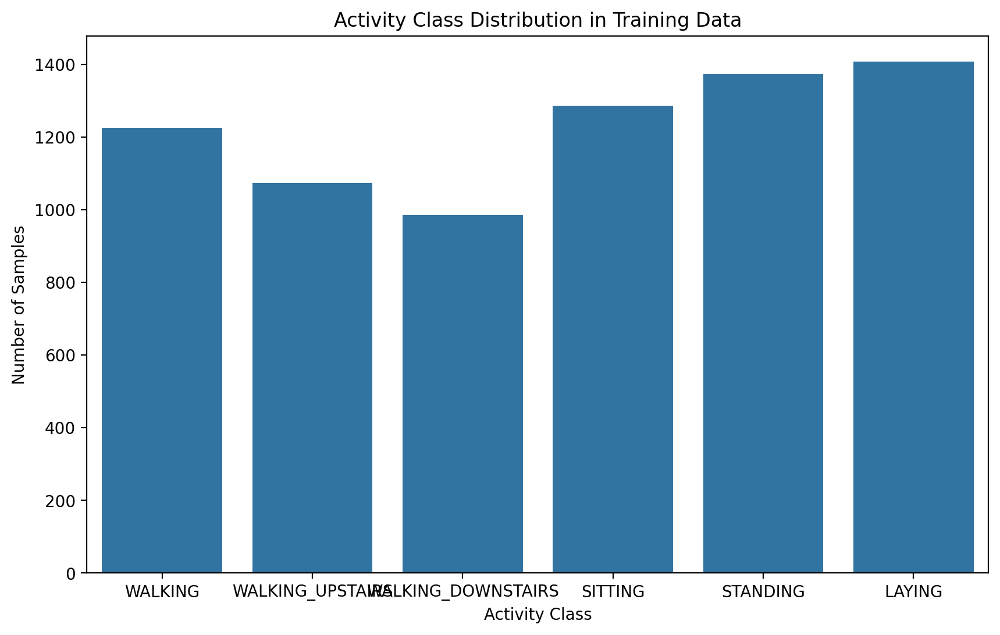

In [5]:
# Calculate the distribution of activity classes in the training set
classes, class_counts = np.unique(y_train, return_counts=True)
activity_map = {
    1: "WALKING",
    2: "WALKING_UPSTAIRS",
    3: "WALKING_DOWNSTAIRS",
    4: "SITTING",
    5: "STANDING",
    6: "LAYING"
}
print(class_counts)
plt.figure(figsize=(10, 6))
sns.barplot(x=list(activity_map.values()), y=class_counts)
plt.title("Activity Class Distribution in Training Data")
plt.xlabel("Activity Class")
plt.ylabel("Number of Samples")
plt.show()

We can see imbalanced class distribution, hence we have to fix that by taking equal number of samples from each class   
$\rightarrow$ taking 900 samples from each

In [82]:
n_samples = 900
X_train_sampled = []
y_train_sampled = []
for i in range(1, 7):
    class_samples = X_train[y_train == i][:n_samples]
    X_train_sampled.append(class_samples)
    y_train_sampled.extend([i] * n_samples)
X_train = np.vstack(X_train_sampled)
y_train = np.array(y_train_sampled)
print(X_train.shape, y_train.shape)
# Calculate the distribution of activity classes in the sampled training set
classes, class_counts = np.unique(y_train, return_counts=True)
print(class_counts)

(5400, 128, 3) (5400,)
[900 900 900 900 900 900]


We will standardize the data as well

In [ ]:
X_train_segmented = (X_train_segmented - np.mean(X_train_segmented, axis=1, keepdims=True)) / np.std(X_train_segmented, axis=1, keepdims=True)
X_train_segmented = np.nan_to_num(X_train_segmented)  # Replace NaN values with 0
print(f"Normalized data shape: {X_train_segmented.shape}")

Visualizing some signals


Randomly selected sample index: 1824
Activity Label: 3 - WALKING_DOWNSTAIRS


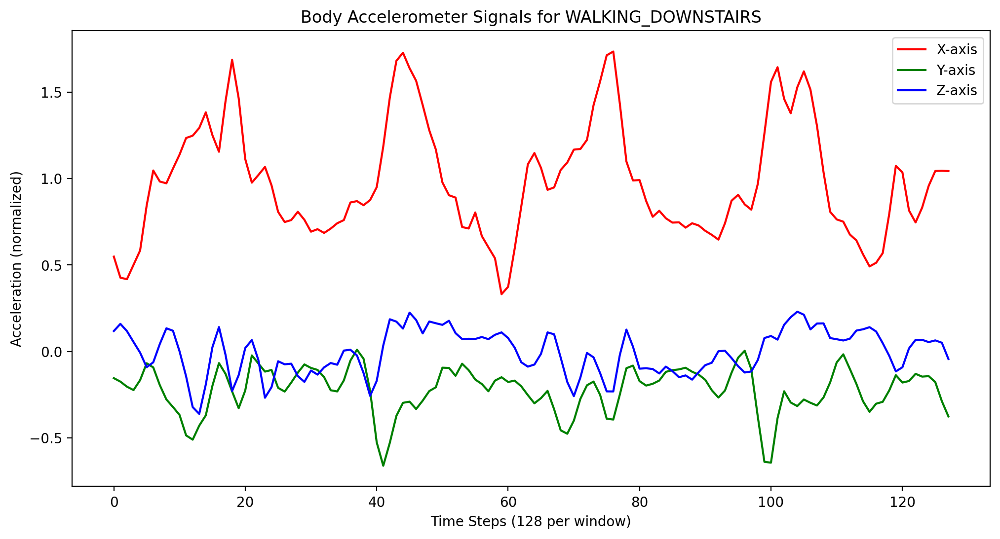

In [85]:
def visualise_sample(data):
    '''Visualizes a random sample of the body accelerometer data'''
    sample_index = random.randint(0, len(y_train) - 1)  # Random index within the dataset
    print(f"Randomly selected sample index: {sample_index}")
    activity_label = int(y_train[sample_index])  
    activity_name = activity_map[activity_label ]
    print(f"Activity Label: {activity_label} - {activity_name}")

    acc_x = data[sample_index, :, 0]  # Body accelerometer signal for X-axis
    acc_y = data[sample_index, :, 1]  # Body accelerometer signal for Y-axis
    acc_z = data[sample_index, :, 2]  # Body accelerometer signal for Z-axis

    plt.figure(figsize=(12, 6))
    plt.plot(acc_x, label='X-axis', color='r')
    plt.plot(acc_y, label='Y-axis', color='g')
    plt.plot(acc_z, label='Z-axis', color='b')
    plt.title(f"Body Accelerometer Signals for {activity_name}")
    plt.xlabel("Time Steps (128 per window)")
    plt.ylabel("Acceleration (normalized)")
    plt.legend()
    plt.show()

visualise_sample(X_train)

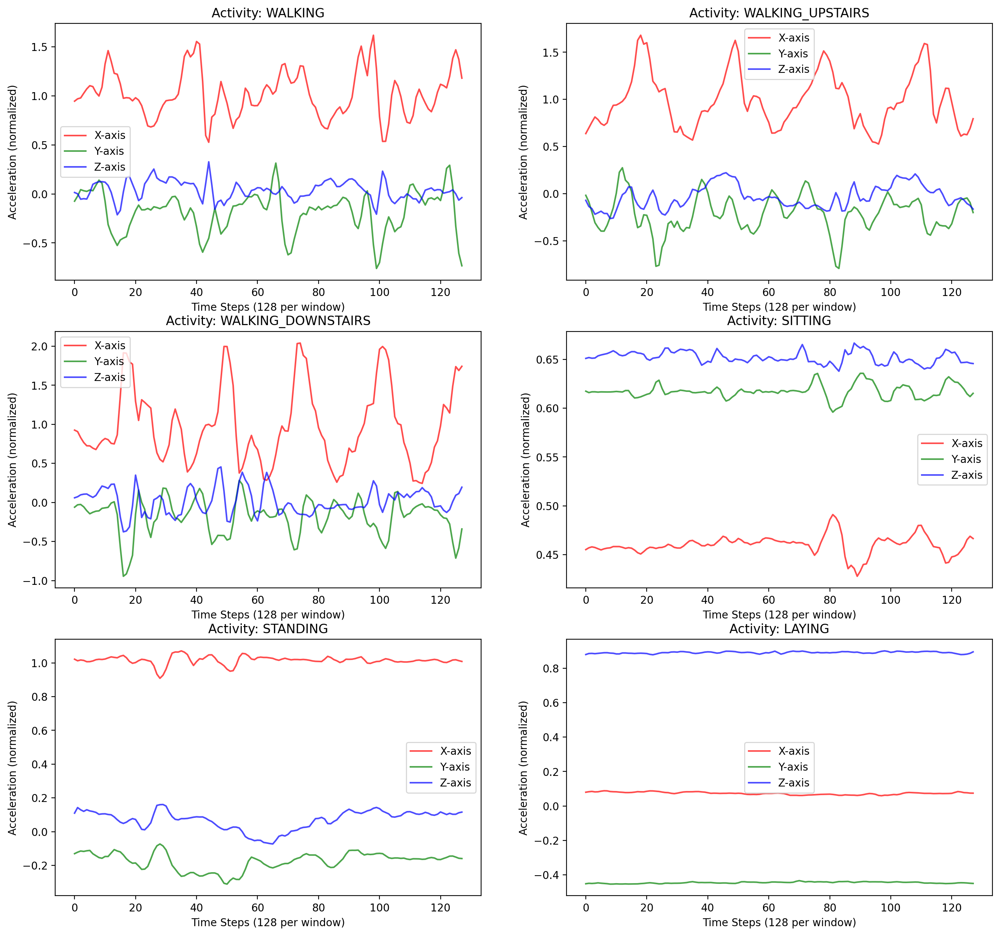

In [7]:
# Select and visualize one sample for each activity
activity_samples = {activity: np.where(y_train == activity)[0][random.randint(0, 1000)] for activity in activity_map.keys()}
plt.figure(figsize=(16, 15))
for i, (activity, sample_index) in enumerate(activity_samples.items()):
    plt.subplot(3, 2, i + 1)
    acc_x = X_train[sample_index, :, 0]
    acc_y = X_train[sample_index, :, 1]
    acc_z = X_train[sample_index, :, 2]
    plt.plot(acc_x, label='X-axis', color='r', alpha=0.7)
    plt.plot(acc_y, label='Y-axis', color='g', alpha=0.7)
    plt.plot(acc_z, label='Z-axis', color='b', alpha=0.7)
    plt.title(f"Activity: {activity_map[activity]}")
    plt.xlabel("Time Steps (128 per window)")
    plt.ylabel("Acceleration (normalized)")
    plt.legend()

#### __Task 1__: Preprocessing the Time-Series Data
1. Load the HAR dataset and segment the time series into overlapping windows.

In [8]:
def segment_multivariate_time_series(data, window_size=128, overlap=0.5, method='sample'):
    """
    Segment multivariate time-series data into overlapping windows.
    
    Parameters:
        data (shape: [n_samples, length of reading, n_features]).
        window_size (int): Size of each window.
        overlap (float): Fraction of overlap between consecutive windows.
        method (str): Method to use for windowing. 'sample' or 'mean'.
    Returns:
        list: (shape: [n_windows, window_size, n_features]).
    """
    step_size = int(window_size * (1 - overlap))
    n_samples = len(data)
    samples = np.zeros((n_samples, (data.shape[1] - window_size) // step_size + 1, data.shape[2]))

    for i in range(n_samples):
        window_means = []
        for j in range(0, data.shape[1] - window_size + 1, step_size):
            window = data[i, j:j + window_size, :]
            if method == 'sample':
                window_means.append(window[0, :])
            elif method == 'mean':
                window_means.append(window.mean(axis=0))
            
        samples[i] = window_means
    
    return samples  # Shape: [n_windows, n_windows, n_features]

Segmented data shape: (7352, 64, 3)
Randomly selected sample index: 4151
Activity Label: 2 - WALKING_UPSTAIRS


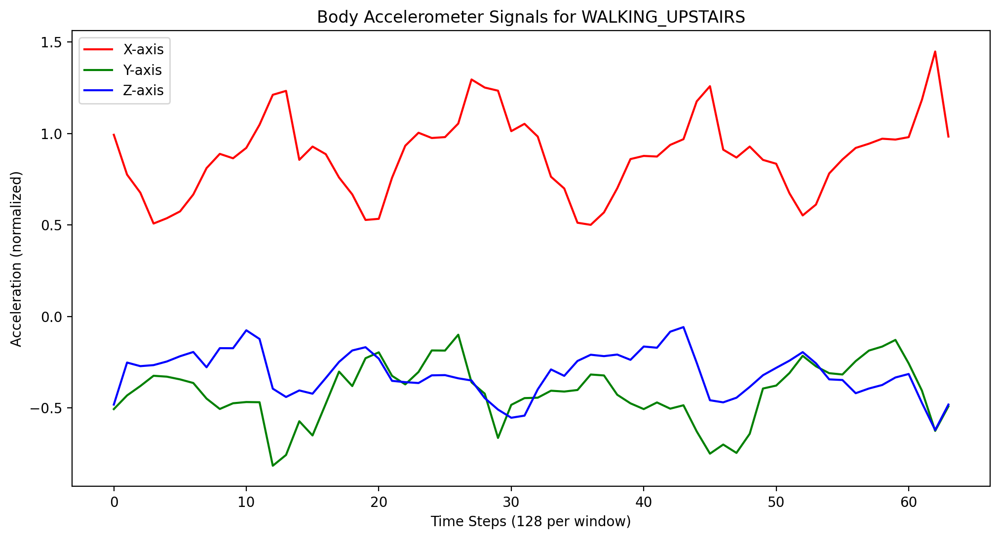

In [9]:
def preprocess_data(X, window_size=128, overlap=0.5, method='sample'):
    '''Preprocesses the data by segmenting and subsampling/downscaling it'''
    X_segmented = segment_multivariate_time_series(X, window_size=window_size, overlap=overlap, method = method)
    print(f"Segmented data shape: {X_segmented.shape}")
    visualise_sample(X_segmented)
    return X_segmented

X_train_segmented = preprocess_data(X_train, window_size=2, overlap=0, method='sample')

2. Compute pairwise distances between time-series segments using:
    - Dynamic Time Warping (DTW) distance
    - Euclidean distance
3. Construct a similarity matrix $W$, where $W_{i,j}$ measures similarity between time-series $x_i$ and $x_j$

We will first Standardize the signals as well

__DTW__

We can use 2 algorithms here, according to the paper [ Generalizing DTW to the multi-dimensional case requires an 
adaptive approach](https://pmc.ncbi.nlm.nih.gov/articles/PMC5668684/pdf/nihms885347.pdf).
1. Compute DTW matrices for 3 dimensions (X, Y, Z) seperately and add them for the final d.
1. Redefine $d(q_i, c_j)$ as the cumulative squared Euclidean distances of M data points instead of the single data point used in the more familiar one-dimensional case. 

The 2nd algorithm is the better suited one in this problem, but we have implemented both.

_1st algorithm (individually finding the 3 matrices)_

In [15]:
def compute_multivariate_dtw_matrix_individually(readings):
    """
    Compute DTW distances between multivariate time-series readings.
    
    Parameters:
        reading (np.ndarray): multivariate readings (shape: [n_samples, length, n_features]).
        
    Returns:
        list: DTW distance between each pair of windows.
    """
    dtw_matrices = []
    for i in range(readings.shape[2]):
        data = readings[:, :, i]
        print(f"DTW Matrix for {i}th dimension data with shape: {data.shape}")
        dtw_matrix = dtw.distance_matrix_fast(data)
        dtw_matrices.append(dtw_matrix)
    return np.array(dtw_matrices)

similarity_matrix_dtw = compute_multivariate_dtw_matrix_individually(X_train_segmented)
similarity_matrix_dtw.shape

DTW Matrix for 0th dimension data with shape: (7352, 64)
DTW Matrix for 1th dimension data with shape: (7352, 64)
DTW Matrix for 2th dimension data with shape: (7352, 64)


(3, 7352, 7352)

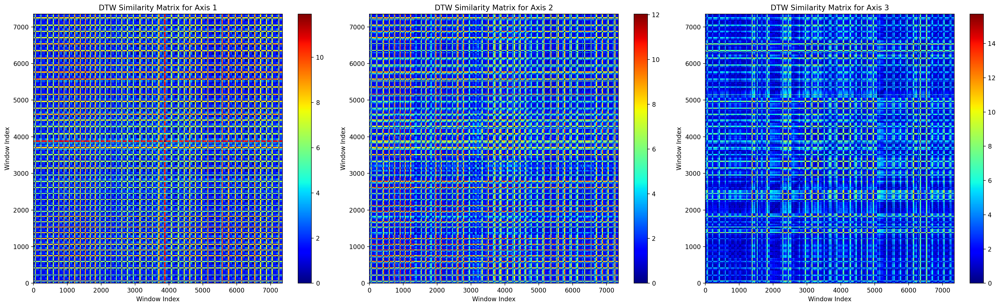

In [16]:
# plot a spectrogram for the DTW similarity matrix 
def plot_similarity_matrices(label, similarity_matrix):
    plt.figure(figsize=(23, 7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        plt.pcolormesh(similarity_matrix[i], cmap='jet')
        plt.colorbar()
        plt.title(f"{label} Similarity Matrix for Axis {i + 1}")
        plt.xlabel("Window Index")
        plt.ylabel("Window Index")
    plt.tight_layout()
    plt.show()

plot_similarity_matrices("DTW", similarity_matrix_dtw)

_2nd Algorithm (computing 1 single matrix, with redefined $d_i 's$)_

In [10]:
def compute_multivariate_dtw_matrix_ndim(X, parallel=False):
    '''Computes the DTW distance matrix for multivariate time series data'''
    return dtw_ndim.distance_matrix_fast(X, parallel=parallel)

n_dim_dtw = compute_multivariate_dtw_matrix_ndim(X_train_segmented, parallel=True)

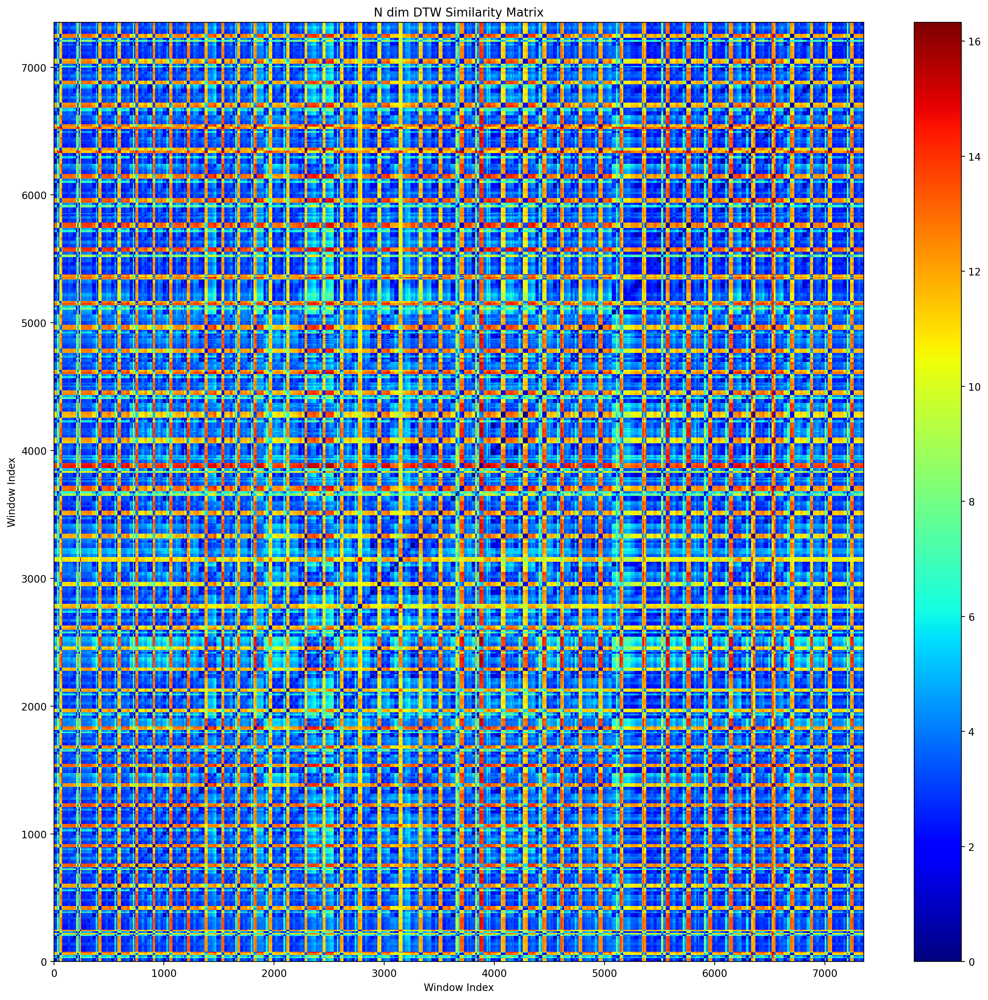

In [11]:
def plot_single_similarity_matrix(similarity_matrix):
    plt.figure(figsize=(15, 14))
    plt.pcolormesh(similarity_matrix, cmap='jet')
    plt.colorbar()
    plt.title("N dim DTW Similarity Matrix")
    plt.xlabel("Window Index")
    plt.ylabel("Window Index")
    plt.tight_layout()
    plt.show()

plot_single_similarity_matrix(n_dim_dtw)

__Euclidean__

In [ ]:
def compute_multivariate_euclidean_matrix(readings):
    """
    Compute DTW distances between multivariate time-series readings.
    
    Parameters:
        reading (np.ndarray): multivariate readings (shape: [n_samples, length, n_features]).
        
    Returns:
        list: DTW distance between each pair of windows.
    """
    dtw_matrices = []
    for i in range(readings.shape[2]):
        data = readings[:, :, i]
        print(f"calculating Euclidean distances Matrix for {i}th dimension data with shape: {data.shape}")
        dist_matrix = distance.cdist(data, data, 'euclidean')
        dtw_matrices.append(dist_matrix)
    return np.array(dtw_matrices)

similarity_matrix_euclidean= compute_multivariate_euclidean_matrix(X_train_segmented)
similarity_matrix_euclidean.shape

calculating Euclidean distances Matrix for 0th dimension data with shape: (7352, 64)
calculating Euclidean distances Matrix for 1th dimension data with shape: (7352, 64)
calculating Euclidean distances Matrix for 2th dimension data with shape: (7352, 64)


(3, 7352, 7352)

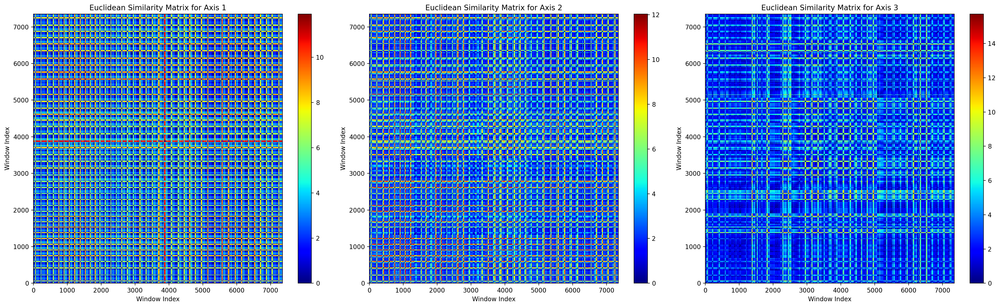

In [ ]:
# plot a spectrogram for the euclidean similarity matrix 
plot_similarity_matrices("Euclidean", similarity_matrix_euclidean)

#### __Task 2__: Apply Diffusion Maps for Dimensionality Reduction


1. Construct the Diffusion Kernel: 
#### $$K_{i,j} = e^{(-\frac{d(x_i, x_j)^2}{\epsilon})}$$ 
where $d(x_i, x_j)$ is the DTW distance. epsilon can be the median of the similarity matrix, or the median squared.

$\rightarrow$ applying Diffusion Kernel on DTW Similarity Matrix  
$\therefore$ large distances $\rightarrow$ 0

_Applying on DTW matrices from 1st algorithm_

In [12]:
epsilon = np.median(n_dim_dtw) ** 2

def diffusion_kernel(d, epsilon=epsilon):
	return np.exp(-d ** 2 / epsilon)

In [17]:
diffusion_matrix_dtw= diffusion_kernel(similarity_matrix_dtw)

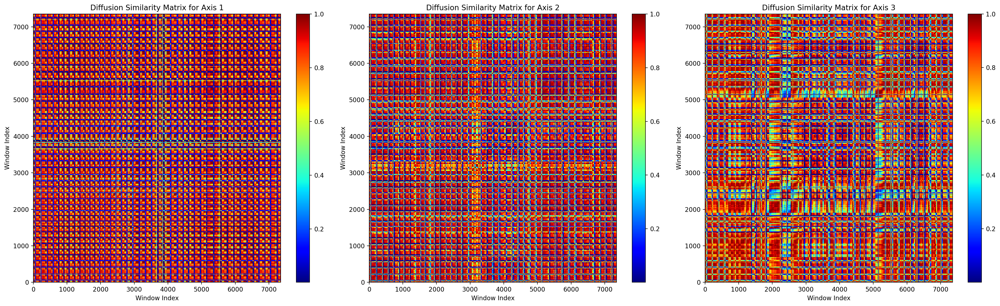

In [18]:
plot_similarity_matrices("Diffusion", diffusion_matrix_dtw)

_Applying on single DTW Matrix computed using 2nd Algorithm_

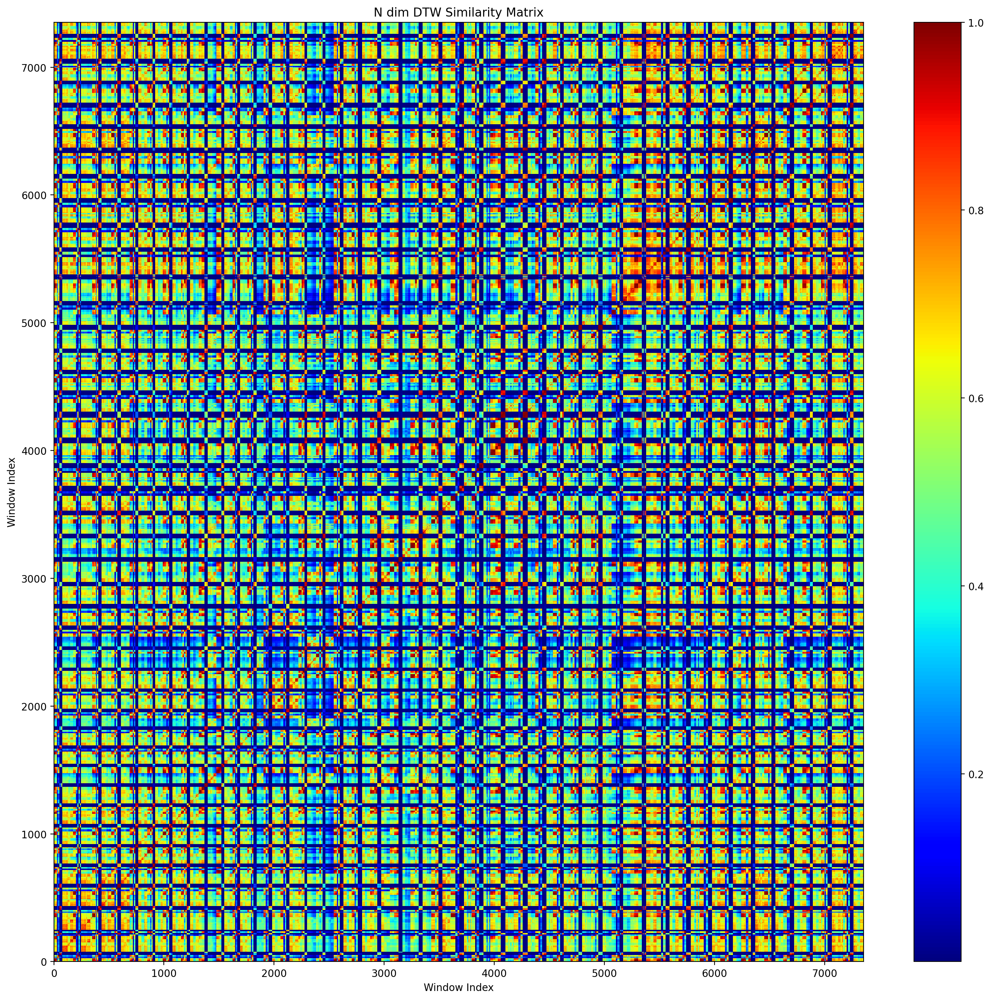

In [14]:
diffusion_matrix_dtw_ndim =  diffusion_kernel(n_dim_dtw)

plot_single_similarity_matrix(diffusion_matrix_dtw_ndim)

2. Compute the __normalized graph Laplacian__ for Diffusion Maps and its leading eigenvectors.
$$L^{\alpha} = D^{-\frac{1}{2}} A D^{-\frac{1}{2}} $$
$$L = (D^\alpha)^{-1} \cdot L^{\alpha}$$


In [19]:
#comopute the normalized laplacian matrix
def compute_normalized_laplacian(matrix):
    """
    Compute the normalized Laplacian matrix for a given similarity matrix.
    
    Parameters:
        matrix (np.ndarray): Similarity matrices in 3 dimensions.
        
    Returns:
        np.ndarray: Normalized Laplacian matrices.
    """
    Ls = []
    for i in range(matrix.shape[0]):
        D = np.diag(np.sum(matrix[i], axis=1) ** -0.5)  # D^(-1/2)
        L = D @ matrix[i] @ D
        D = np.diag(np.sum(L, axis=1))  # L alpha
        L_final = np.linalg.inv(D) @ L
        Ls.append(L_final)
    return np.array(Ls)

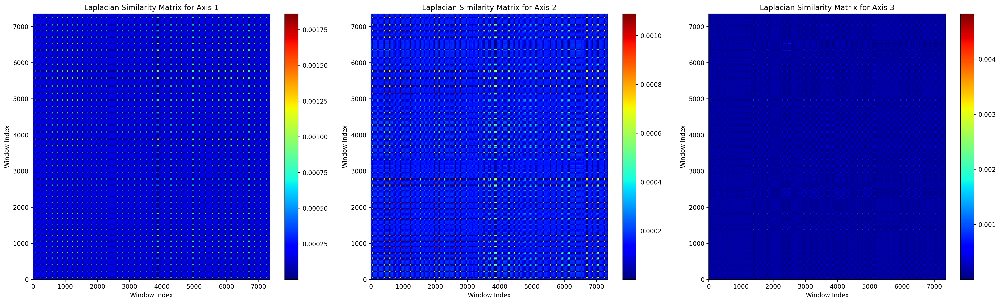

In [20]:
laplacian_matrix_dtw = compute_normalized_laplacian(diffusion_matrix_dtw)
plot_similarity_matrices("Laplacian", laplacian_matrix_dtw)

_Finding Normalized Laplacian of the DTW Diffusion matrix from 2nd algorithm_

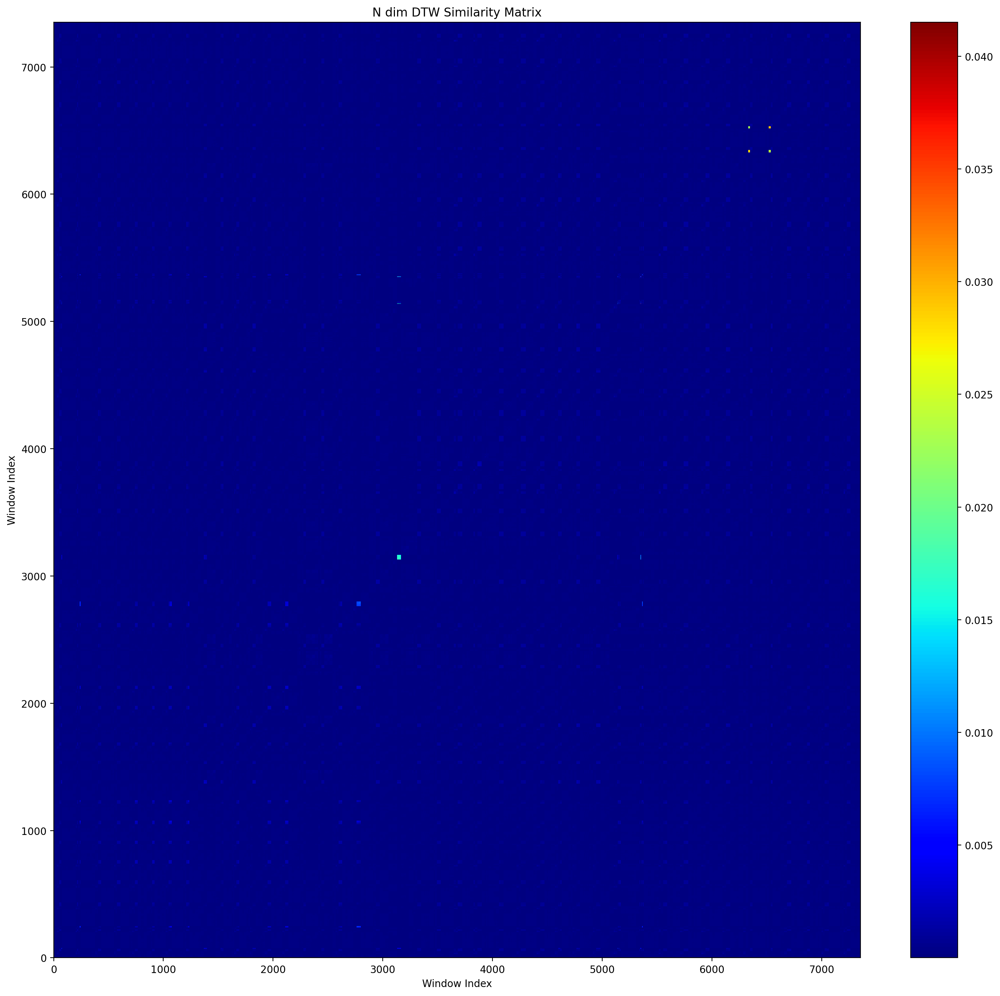

In [21]:
laplacian_matrix_dtw_ndim = compute_normalized_laplacian(np.array([diffusion_matrix_dtw_ndim]))[0]
plot_single_similarity_matrix(laplacian_matrix_dtw_ndim)

In [33]:
def compute_eigenvectors(laplacian_matrix, n_components=2):
    """
    Compute the leading eigenvectors of the Laplacian matrix.
    
    Parameters:
        laplacian_matrix (np.ndarray): Normalized Laplacian matrices in n dimensions.
        n_components (int): Number of eigenvectors to compute.
        
    Returns:
        np.ndarray: Leading eigenvectors for n matrices
    """
    eigenvectors = []
    eigenvalues = []
    for i in range(laplacian_matrix.shape[0]):
        print(f"Computing eigenvectors for {i}th Laplacian matrix")
        eigvals, eigvecs = eigh(laplacian_matrix[i])
        eigvals = np.real(eigvals)
        eigvecs = np.real(eigvecs)
        idx = eigvals.argsort()[::-1]
        sorted_eigvals = eigvals[idx]
        print(sorted_eigvals)
        # taking top n eigenvectors
        eigenvalues.append(sorted_eigvals[:n_components])
        eigenvectors.append(eigvecs[:, idx[:n_components]])
        
    return np.array(eigenvalues), np.array(eigenvectors)

Computing the top eigenvectors for the 2nd DTW matrix only.

In [34]:
eigenvalues_dtw, eigenvectors_dtw = compute_eigenvectors(np.array([laplacian_matrix_dtw_ndim]), n_components=3)
eigenvalues_dtw = eigenvalues_dtw[0]
eigenvectors_dtw = eigenvectors_dtw[0]
eigenvalues_dtw.shape, eigenvectors_dtw.shape

Computing eigenvectors for 0th Laplacian matrix
[ 0.99729488  0.95679471  0.95491238 ... -0.01027404 -0.01235004
 -0.01595931]


((3,), (7352, 3))

In [42]:
weighted_eigenvectors = [eigenvectors_dtw[:, i] * eigenvalues_dtw[i] for i in range(eigenvectors_dtw.shape[1])]
weighted_eigenvectors

[array([-0.01310466, -0.01311754, -0.01313252, ..., -0.01205414,
        -0.01205589, -0.01205323]),
 array([-0.00173713, -0.00173983, -0.00174598, ..., -0.00173604,
        -0.00173957, -0.00174795]),
 array([0.00506711, 0.0050735 , 0.00508624, ..., 0.00489267, 0.00489765,
        0.00490637])]

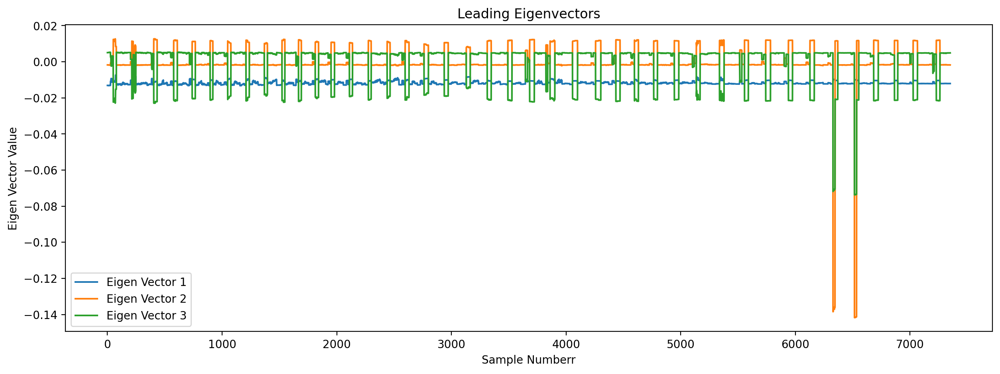

In [43]:
#plot the eighenvectors * eigenvalues
weighted_eigenvectors = eigenvectors_dtw * eigenvalues_dtw
def plot_eigenvectors(eigenvectors):
    plt.figure(figsize=(15, 5))
    for i in range(eigenvectors.shape[1]):
        plt.plot(weighted_eigenvectors[:, i], label=f"Eigen Vector {i + 1}")
    plt.title("Leading Eigenvectors")
    plt.xlabel("Sample Numberr")
    plt.ylabel("Eigen Vector Value")
    plt.legend()
    plt.show()
plot_eigenvectors(eigenvectors_dtw)

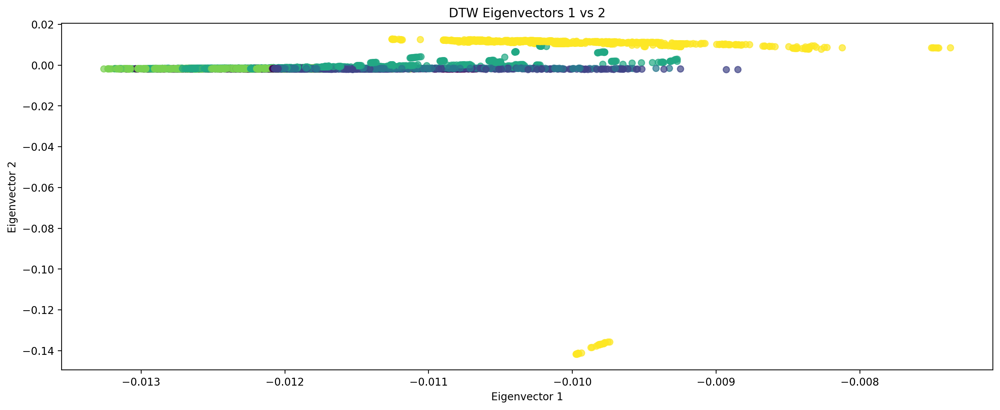

In [44]:
# plot the first 2 eigenvectors ibn a 2D space
plt.figure(figsize=(16, 6))
plt.scatter(weighted_eigenvectors[:, 0], weighted_eigenvectors[:, 1], c=y_train, cmap='viridis', alpha=0.7)
plt.title(f"DTW Eigenvectors { 1} vs {2}")
plt.xlabel("Eigenvector 1")
plt.ylabel("Eigenvector 2")
plt.show()

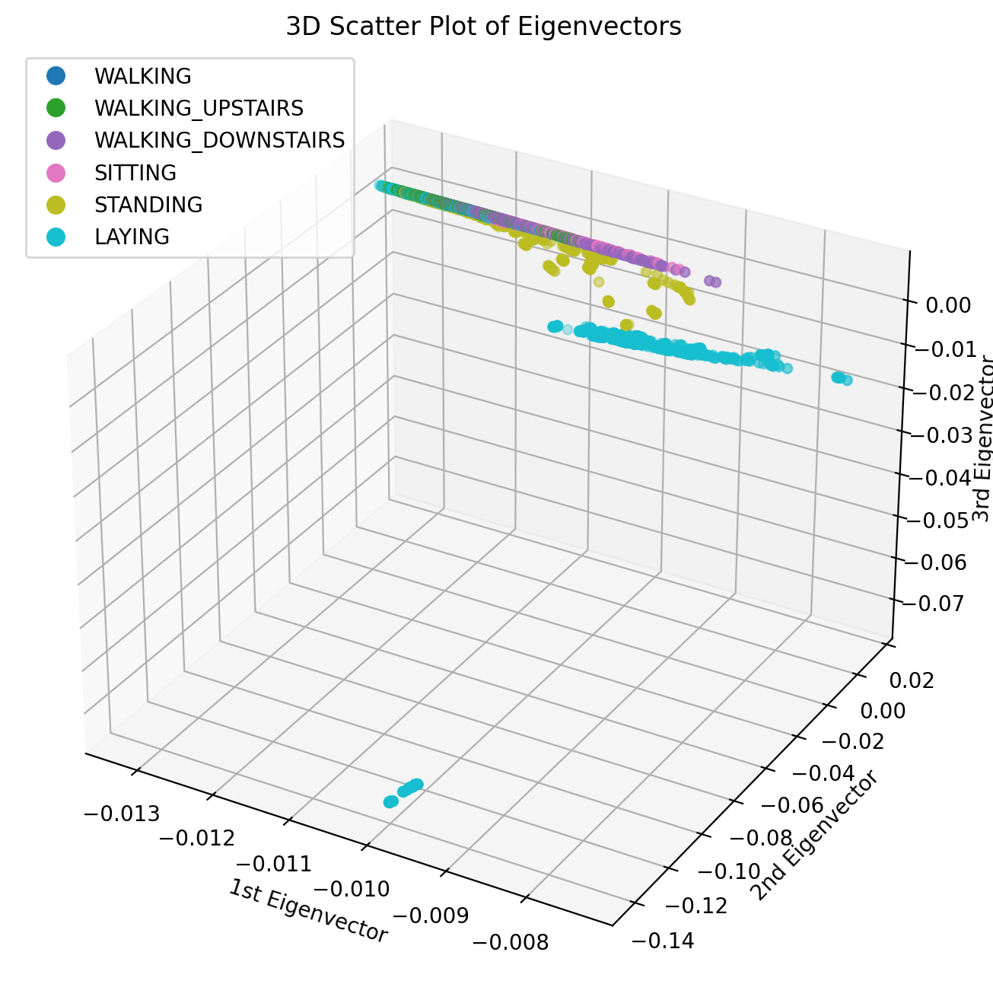

(7352, 3)

In [45]:
#3d plot for eigenvectors
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Use tab10 colormap
cmap = plt.get_cmap('tab10')
norm = mcolors.Normalize(vmin=0, vmax=len(activity_map) - 1)

# Scatter plot
scatter = ax.scatter(weighted_eigenvectors[:, 0], weighted_eigenvectors[:, 1], weighted_eigenvectors[:, 2], c=y_train, cmap=cmap, norm=norm)

# Create legend
legend_labels = list(activity_map.values())
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=cmap(norm(i)), markersize=10) for i in range(len(legend_labels))]
ax.legend(handles=handles, labels=legend_labels)

ax.set_xlabel('1st Eigenvector')
ax.set_ylabel('2nd Eigenvector')
ax.set_zlabel('3rd Eigenvector')
plt.title("3D Scatter Plot of Eigenvectors")
plt.show()

weighted_eigenvectors.shape

In [56]:
kmeans = KMeans(n_clusters=6, random_state=42)
kmeans.fit(weighted_eigenvectors)
y_train_kmeans = kmeans.labels_
print(y_train_kmeans.shape)

print("ARI for KMeans", adjusted_rand_score(y_train_kmeans, y_train))

(7352,)
ARI for KMeans 0.1334626514459947


3. Use the top 2 or 3 diffusion coordinates to embed the time series into a __low-dimensional space.__

In [48]:
# transform the data to the new space
def transform_data(data, eigenvectors):
    """
    Transform the data into the new space defined by the eigenvectors.
    
    Parameters:
        data (np.ndarray): Data in the original space.
        eigenvectors (np.ndarray): Leading eigenvectors.
        
    Returns:
        np.ndarray: Data in the new space.
    """
    transformed_data = []
    for i in range(data.shape[0]):
        one_dim_data = data[i, :, :]
        print(f"Transforming data for {i}th dimension with shape: {one_dim_data.shape}")
        transformed = one_dim_data @ eigenvectors[i]
        transformed_data.append(transformed)
    return np.array(transformed_data)

X_train_transformed_dtw = transform_data(np.array([n_dim_dtw]), np.array([weighted_eigenvectors]))[0]

Transforming data for 0th dimension with shape: (7352, 7352)


In [49]:
X_train_transformed_dtw.shape

(7352, 3)

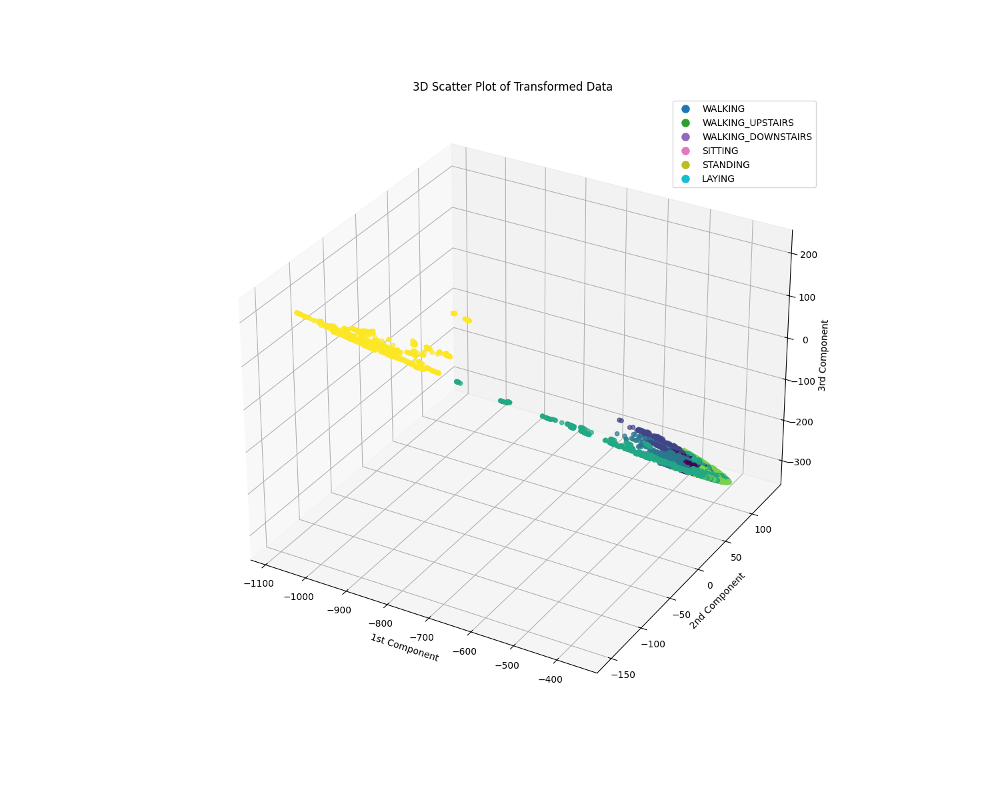

In [50]:
# Enable interactive Matplotlib backend
%matplotlib widget
#3d plot for transformed data
fig = plt.figure(figsize=(15, 12))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X_train_transformed_dtw[:, 0], X_train_transformed_dtw[:, 1], X_train_transformed_dtw[:, 2], c=y_train, cmap='viridis', alpha=0.7)
ax.set_xlabel('1st Component')
ax.set_ylabel('2nd Component')
ax.set_zlabel('3rd Component')
ax.legend(handles=handles, labels=legend_labels)
plt.title("3D Scatter Plot of Transformed Data")
plt.show()

#### __Task 3__: Clustering in the Diffusion Space
1. Apply K-Means or DBSCAN to the diffusion map embeddings.

In [60]:
# apply kmeans clustering on the transformed data
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=6, random_state=42)
kmeans.fit(X_train_transformed_dtw)
y_train_kmeans = kmeans.labels_
y_train_kmeans.shape

(7352,)

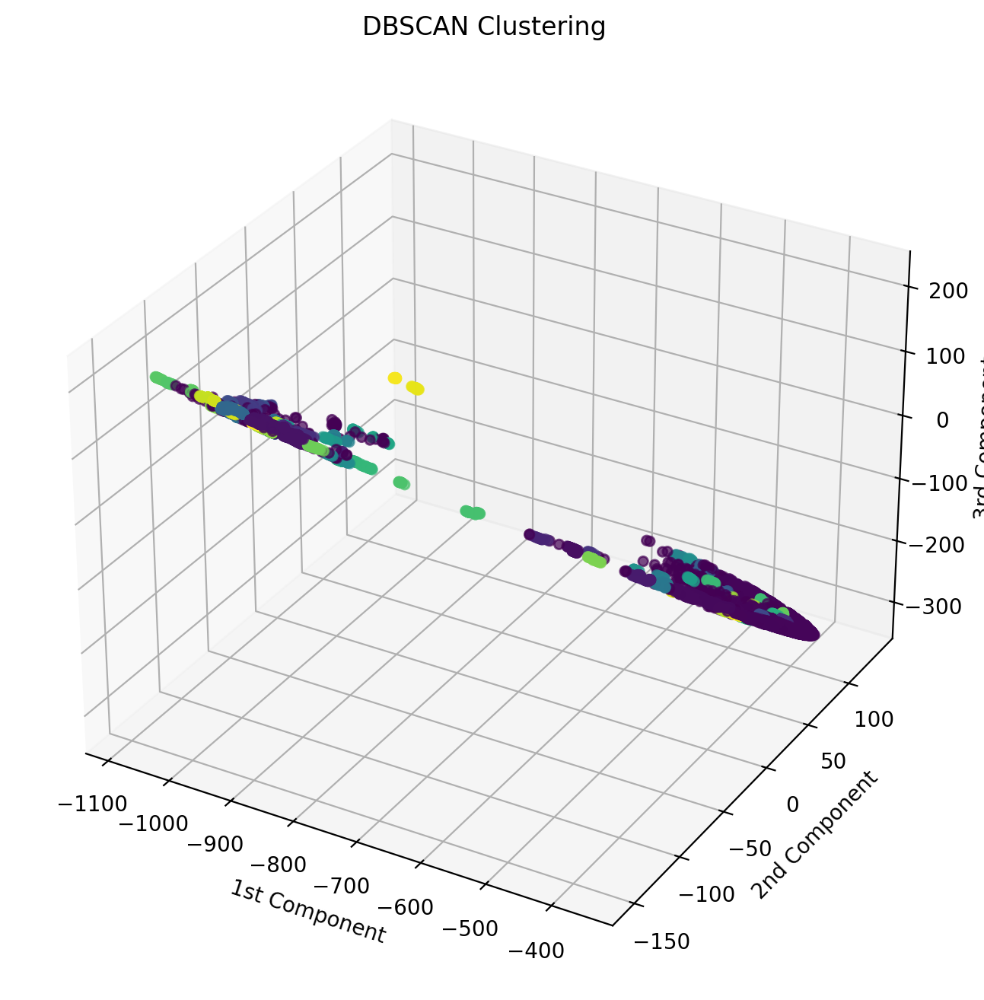

(7352,)

In [69]:
# apply DbScan clustering on the transformed data
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=5, min_samples=5)
dbscan.fit(X_train_transformed_dtw)
y_train_dbscan = dbscan.labels_

#visualize the clustering results for dbscan in 3d
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X_train_transformed_dtw[:, 0], X_train_transformed_dtw[:, 1], X_train_transformed_dtw[:, 2], c=y_train_dbscan, cmap='viridis', alpha=0.7)
ax.set_xlabel('1st Component')
ax.set_ylabel('2nd Component')
ax.set_zlabel('3rd Component')
plt.title("DBSCAN Clustering")
plt.show()
y_train_dbscan.shape

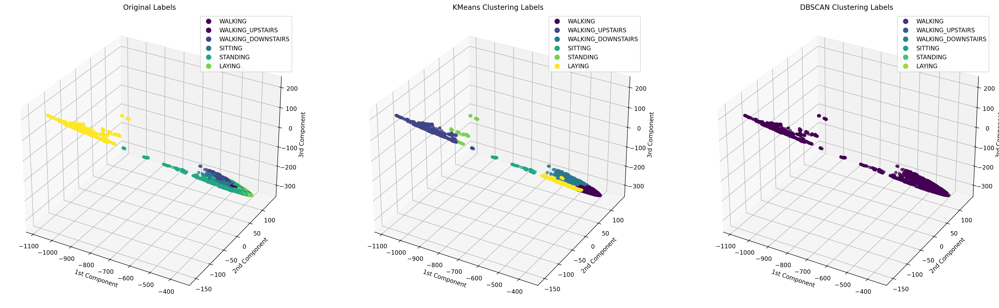

In [62]:
# Disable interactive Matplotlib backend
%matplotlib inline
def plot_comparison_3d(X_train_transformed, y_trains, titles, cmap):
    fig = plt.figure(figsize=(30, 12))
    num_plots = len(y_trains)
    
    for i in range(num_plots):
        ax = fig.add_subplot(1, num_plots, i + 1, projection='3d')
        scatter = ax.scatter(X_train_transformed[:, 0], X_train_transformed[:, 1], X_train_transformed[:, 2], c=y_trains[i], cmap=cmap, alpha=0.7)
        ax.set_xlabel('1st Component')
        ax.set_ylabel('2nd Component')
        ax.set_zlabel('3rd Component')
        ax.set_title(titles[i])
        
        # Create legend
        legend_labels = list(activity_map.values())
        handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=scatter.cmap(scatter.norm(j)), markersize=10) for j in range(len(legend_labels))]
        ax.legend(handles=handles, labels=legend_labels)
    
    plt.show()

# Example usage
y_trains = [y_train, y_train_kmeans, y_train_dbscan]
titles = ["Original Labels", "KMeans Clustering Labels", "DBSCAN Clustering Labels"]
cmap = 'viridis'

plot_comparison_3d(X_train_transformed_dtw, y_trains, titles, cmap)

2. Evaluate clustering performance using:
    - Adjusted Rand Index (ARI)
    - Silhouette Score

In [63]:
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import silhouette_score

print("ARI for KMeans", adjusted_rand_score(y_train_kmeans, y_train))
print("Silhouette score for KMeans", silhouette_score(X_train_transformed_dtw, y_train_kmeans))

ARI for KMeans 0.3061631548438282
Silhouette score for KMeans 0.5086094815673676


In [70]:
print("ARI for DBSCAN", adjusted_rand_score(y_train_dbscan, y_train))
print("Silhouette score for DBSCAN", silhouette_score(X_train_transformed_dtw, y_train_dbscan))

ARI for DBSCAN 0.10058647067603009
Silhouette score for DBSCAN -0.29624480550952675


#### __Task 4__: Visualization and Interpretation
1. Scatter Plot the diffusion embeddings, color-coded by activity labels. _Done Above_
2. Compare clustering quality using:
    - Raw feature space
    - PCA
    - t-SNE
    - Diffusion Maps

- Raw Signals

In [75]:
# flattening the data into sigle dimension
X_train_flatten = X_train_segmented.reshape(X_train_segmented.shape[0], -1)

kmeans = KMeans(n_clusters=6, random_state=42)
kmeans.fit(X_train_flatten)
y_train_kmeans_raw = kmeans.labels_
print("ARI for Raw Signals (KMeans)", adjusted_rand_score(y_train_kmeans_raw, y_train))
print("Silhouette score for Raw Signals (KMeans)", silhouette_score(X_train_flatten, y_train_kmeans_raw))

dbscan = DBSCAN(eps=2, min_samples=30)
dbscan.fit(X_train_flatten)
y_train_dbscan_raw = dbscan.labels_
print("ARI for Raw Signals (DBSCAN)", adjusted_rand_score(y_train_dbscan_raw, y_train))
print("Silhouette score for Raw Signals (DBSCAN)", silhouette_score(X_train_flatten, y_train_dbscan_raw))

ARI for Raw Signals (KMeans) 0.1855608046603372
Silhouette score for Raw Signals (KMeans) 0.24131427642334816
ARI for Raw Signals (DBSCAN) 0.2654692224865638
Silhouette score for Raw Signals (DBSCAN) 0.07047601955108938


- PCA

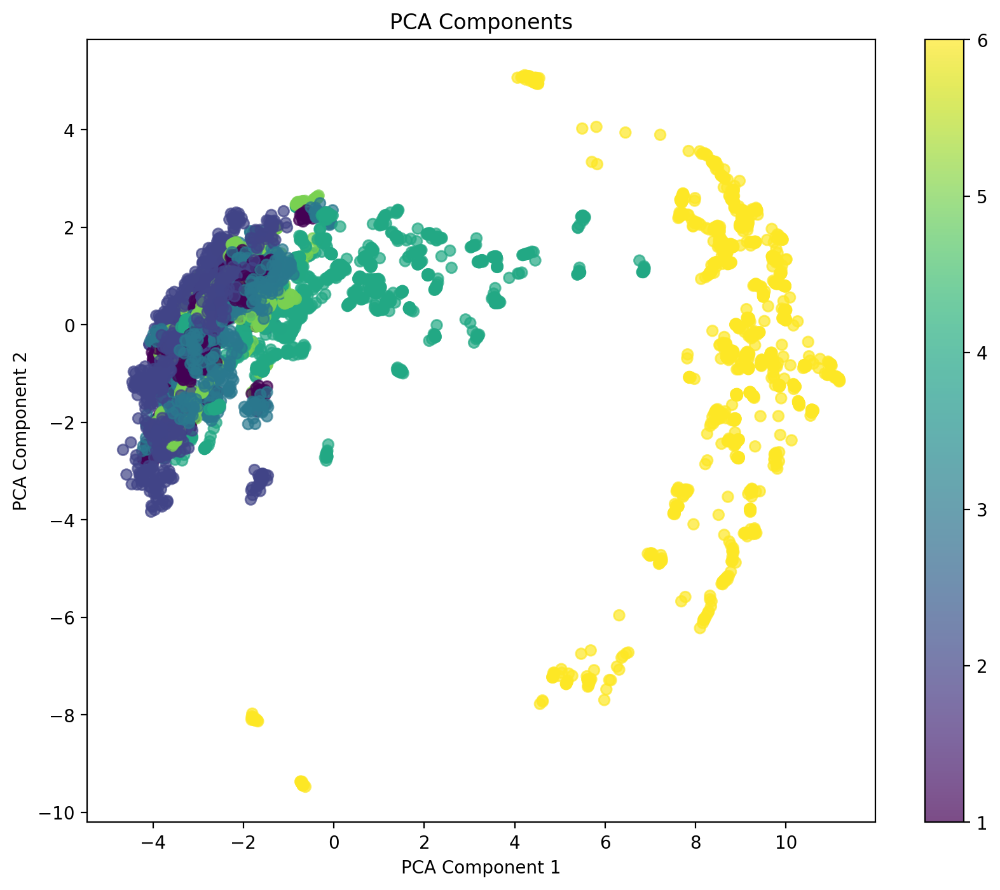

ARI for PCA  (KMeans) 0.21111252191923122
Silhouette score for PCA (KMeans) 0.3598768330700726
ARI for Raw Signals (DBSCAN) -0.0008488600089921312
Silhouette score for Raw Signals (DBSCAN) 0.4668719573048363


In [79]:
# clustering after applying pca
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
X_train_pca = pca.fit_transform(X_train_flatten)
#plot the pca components
plt.figure(figsize=(10, 8))
plt.scatter(X_train_pca[:, 0], X_train_pca[:, 1], c=y_train, cmap='viridis', alpha=0.7)
plt.title("PCA Components")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.colorbar()
plt.show()

kmeans = KMeans(n_clusters=6, random_state=42)
kmeans.fit(X_train_pca)
y_train_kmeans_pca = kmeans.labels_
print("ARI for PCA  (KMeans)", adjusted_rand_score(y_train_kmeans_pca, y_train))
print("Silhouette score for PCA (KMeans)", silhouette_score(X_train_pca, y_train_kmeans_pca))

dbscan = DBSCAN(eps=2, min_samples=30)
dbscan.fit(X_train_pca)
y_train_dbscan_pca = dbscan.labels_
print("ARI for Raw Signals (DBSCAN)", adjusted_rand_score(y_train_dbscan_pca, y_train))
print("Silhouette score for Raw Signals (DBSCAN)", silhouette_score(X_train_pca, y_train_dbscan_pca))

- t-SNE

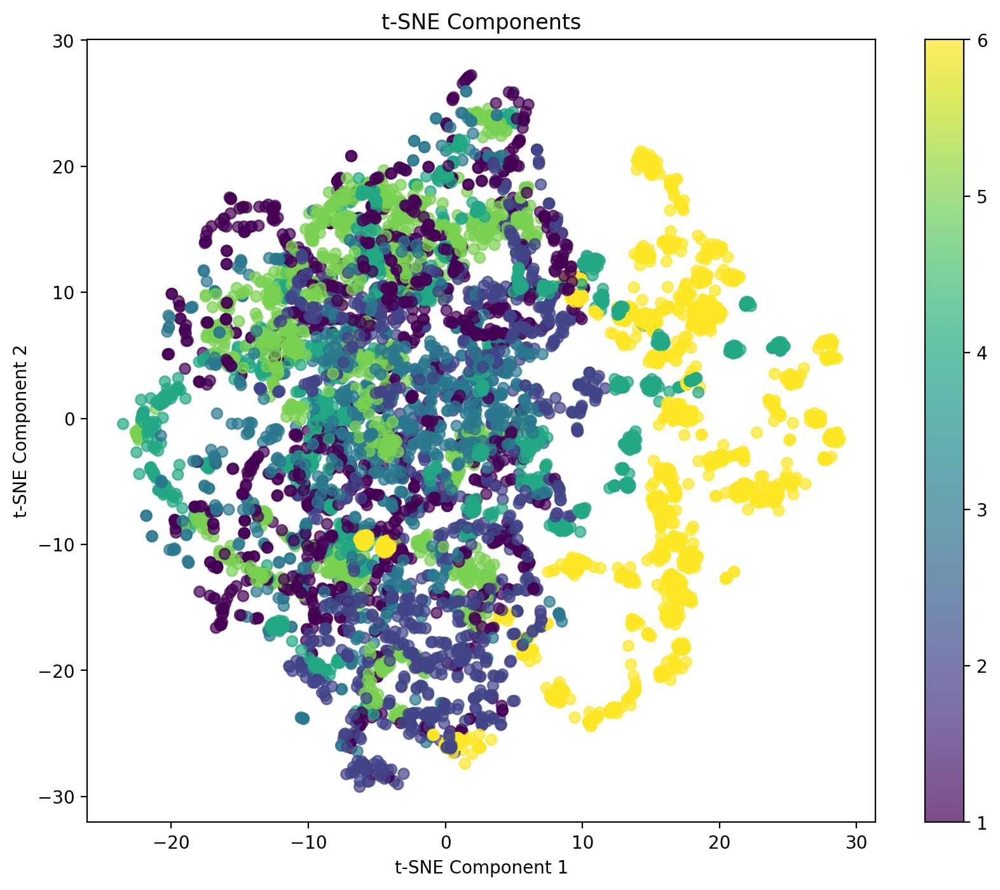

ARI for t-SNE (KMeans) 0.18297716387410884
Silhouette score for t-SNE (KMeans) 0.28417122


In [80]:
#tsne for dimensionality reduction
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler

# Standardize the data
scaler = StandardScaler()
X_train_flatten_scaled = scaler.fit_transform(X_train_flatten)
X_train_flatten_scaled.shape
# Apply t-SNE
tsne = TSNE(n_components=3, random_state=42)
X_train_tsne = tsne.fit_transform(X_train_flatten_scaled)
X_train_tsne.shape
# Plot the t-SNE components
plt.figure(figsize=(10, 8))
plt.scatter(X_train_tsne[:, 0], X_train_tsne[:, 1], c=y_train, cmap='viridis', alpha=0.7)
plt.title("t-SNE Components")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.colorbar()
plt.show()
kmeans = KMeans(n_clusters=6, random_state=42)
kmeans.fit(X_train_tsne)
y_train_kmeans_tsne = kmeans.labels_
print("ARI for t-SNE (KMeans)", adjusted_rand_score(y_train_kmeans_tsne, y_train))
print("Silhouette score for t-SNE (KMeans)", silhouette_score(X_train_tsne, y_train_kmeans_tsne))
